### 프로젝트 변경점
- 사전 학습된 ResNet50을 사용(기존 v1 > v2로 변경)
- optimizer 변경(기존 SGD > AdamW로 변경)

### 프로젝트 결과 분석
- 가정: 모델이 충분히 학습이 되었다는 전제하에 CAM과 Grad GAM의 결과를 분석하기
- CAM과 Grad CAM의 결과는 동일하게 나타나는 것을 볼 수 있다.
    -  이유: 현재 ResNet 구조를 보면, 마지막 Layer에서 AVG(1,1,c)를 사용하고 있기 때문에 GAP을 사용한 것과 같은 결과가 나온다.  
    만약 ResNet의 구조를 변경한다면, CAM과 Grad CAM에서 다른 결과를 확인할 수 있을 것이다. 하지만 CAM과 Grad GAM의 결과를 Ablation Study 관점에서 비교하기 어렵다는 문제가 있다.

- 여기서 주의깊게 살펴볼 것은 Grad CAM이다.  
    - 입력층과 가까운 저차원 레이어는 에지나 텍스처 같은 국소적인 기하학적 특징을 추출하며, 이는 히트맵과 바운딩 박스를 통해 모델이 이미지의 전반적인 기초 윤곽을 탐색하고 있음을 보여준다.  
    - 반대로 출력층에 가까운 레이어(고차원)는 레이어를 거치며 극대화된 Receptive Field을 통해 이미지 전체의 문맥을 통합적으로 수용하며, 고차원의 의미론적 추론을 바탕으로 압축된 특징 맵 속에서 객체의 본질적 형상에만 정보를 집중시켜 인식의 범위를 정교하게 수렴시킨다.

- 사전 학습된 ResNet 모델의 학습 과정에서 훈련 손실($L_{train}$)과 정확도는 최적점으로 점근적 수렴을 보이나, 검증(Validation) 지표는 특정 시점 이후 최적화 정체기(Optimization Plateau)에 진입한 것을 알 수 있다.  

    특히 AdamW의 가중치 감쇠(Weight Decay) 기법이 검증 손실의 급격한 발산을 억제하여 전형적인 과대적합 양상은 나타나지 않지만, 학습이 지속될수록 모델이 객체의 본질적 형상이 아닌 훈련 데이터 특유의 비본질적 노이즈를 암기하게 된다. 이로 인해 수치상의 안정에도 불구하고 실질적인 객체 변별력이 약화되는 일반화 성능 저하가 발생하며, 결과적으로 에포크가 증가할수록 타겟 객체에 대한 탐지 정밀도가 하락하는 결과가 발생한 것을 알 수 있다.


### 회고 
입력층에 인접한 저차원 레이어에서 에지나 텍스처 같은 국소적 특징을 추출하고, 이를 계층적으로 결합하여 고차원 레이어에서 객체의 공간적 위상과 고차원적 의미론적 추론을 수행하는 과정이 인상적이었다.  
특히, 초기 레이어의 시각적 파편들이 여러 단계의 필터를 거치며 Receptive Field를 확장하고, 객체를 인식해나가는 과정에서 인공신경망이 단순한 연산을 넘어 인간의 추론 방식을 공학적으로 재현하고 있음을 알게 되었다.

In [1]:
# !pip install opencv-python, numpy, torch

In [2]:
# !wget http://vision.stanford.edu/aditya86/ImageNetDogs/images.tar
# !wget http://vision.stanford.edu/aditya86/ImageNetDogs/annotation.tar
# !wget http://vision.stanford.edu/aditya86/ImageNetDogs/lists.tar
# !tar -xf images.tar -C ./
# !tar -xf annotation.tar -C ./
# !tar -xf lists.tar -C ./

# print("데이터 다운로드 완료!")

## 프로젝트: CAM을 만들고 평가해 보자

In [3]:
import os
import re
import shutil
import scipy.io as sio
import numpy as np
import cv2
import PIL
import seaborn as sns
import matplotlib.pyplot as plt
import xml.etree.ElementTree as ET

import torch
import torch.nn as nn
import torch.optim as optim
import torch.nn.functional as F
import torchvision.models as models
import torchvision.datasets as datasets
import torchvision.transforms as transforms
from torch.utils.data import DataLoader
from torchvision.models import ResNet50_Weights
from sklearn.metrics import precision_score, recall_score, f1_score, confusion_matrix, roc_auc_score

print(torch.__version__)
print(np.__version__)
print(cv2.__version__)
print(PIL.__version__)

2.10.0+cu128
2.4.2
4.13.0
12.1.0


In [4]:
max_epochs = 10
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


#### 데이터 분류
- stanford_dogs 폴더가 없을 때 실행

In [5]:
# # 원본 데이터 경로 (압축 해제 후 폴더)
# images_dir = './Images'  # 이미지들이 위치한 폴더
# mat_dir = './' # 프로젝트 루트 디렉토리

# # .mat 파일 경로 (train_list.mat와 test_list.mat가 각각 같은 구조라고 가정)
# train_mat_path = os.path.join(mat_dir, 'train_list.mat')
# test_mat_path = os.path.join(mat_dir, 'test_list.mat')

# # .mat 파일 로드
# train_mat = sio.loadmat(train_mat_path)
# test_mat = sio.loadmat(test_mat_path)

# # train_mat와 test_mat 내부에 'file_list'와 'labels' 등이 있음
# train_file_list = train_mat['file_list']
# train_labels = train_mat['labels'].squeeze()  # (N,)
# test_file_list = test_mat['file_list']
# test_labels = test_mat['labels'].squeeze()

# # 최종적으로 ImageFolder 구조로 재구성할 대상 폴더 생성 (예: stanford_dogs/train, stanford_dogs/test)
# base_dir = 'stanford_dogs'
# train_dir = os.path.join(base_dir, 'train')
# test_dir = os.path.join(base_dir, 'test')

# os.makedirs(train_dir, exist_ok=True)
# os.makedirs(test_dir, exist_ok=True)

# def process_mat_file(file_list_array, split_dir):
#     """
#     .mat 파일에서 로드한 file_list_array를 사용해,
#     split_dir(예: train 혹은 test)에 클래스별 폴더를 생성하고 이미지를 복사합니다.
#     """
#     num_files = file_list_array.shape[0]
#     for idx in range(num_files):
#         # file_list_array[idx]는 보통 array([<파일경로>]) 형태입니다.
#         # 따라서, array([<파일경로>]).item()을 사용하면 실제 문자열을 얻을 수 있습니다.
#         file_path = file_list_array[idx][0].item()

#         # 혹시 bytes 타입이면 문자열로 디코딩
#         if isinstance(file_path, bytes):
#             file_path = file_path.decode('utf-8')

#         # 파일 경로 예시: 'n02116738-African_hunting_dog/n02116738_2988.jpg'
#         # 클래스 이름은 파일 경로의 최상위 폴더명 (예: 'n02116738-African_hunting_dog')
#         class_folder = file_path.split('/')[0]

#         # 대상 클래스 폴더 생성
#         dest_folder = os.path.join(split_dir, class_folder)
#         os.makedirs(dest_folder, exist_ok=True)

#         # 원본 이미지 경로: Images 폴더 아래에 file_path 위치
#         src_path = os.path.join(images_dir, file_path)
#         # 대상 이미지 경로: dest_folder 아래에 원본 파일명 그대로 복사
#         dest_path = os.path.join(dest_folder, os.path.basename(file_path))

#         # 파일 존재 여부 확인 후 복사
#         if os.path.exists(src_path):
#             shutil.copy(src_path, dest_path)
#         else:
#             print(f"File not found: {src_path}")

# print("Processing train set...")
# process_mat_file(train_file_list, train_dir)
# print("Processing test set...")
# process_mat_file(test_file_list, test_dir)

# print("Dataset reorganization complete.")

In [6]:
class StanfordDogsDatasetWithBBox(datasets.ImageFolder):
    def __init__(self, root, annotation_root, transform=None):
        super().__init__(root, transform=transform)
        self.annotation_root = annotation_root  # 예: '/content/Annotation'
        self.new_size = (224, 224)

    def __getitem__(self, index):
        image, label = super().__getitem__(index)
        path, _ = self.samples[index]

        rel_path = os.path.relpath(path, self.root)
        annot_filename = os.path.splitext(os.path.basename(rel_path))[0]
        annot_folder = os.path.dirname(rel_path)
        annot_path = os.path.join(self.annotation_root, annot_folder, annot_filename)

        # bbox 기본값 (예: [ymin, xmin, ymax, xmax])
        bbox = [0.0, 0.0, 0.0, 0.0]

        if os.path.exists(annot_path):
            try:
                # 확장자가 없지만 XML 형식의 파일이라고 가정하고 파싱
                tree = ET.parse(annot_path)
                root_xml = tree.getroot()
                # 첫 번째 object 태그에서 bndbox 정보를 읽음
                obj = root_xml.find('object')
                if obj is not None:
                    bndbox = obj.find('bndbox')
                    if bndbox is not None:
                        xmin = float(bndbox.find('xmin').text)
                        ymin = float(bndbox.find('ymin').text)
                        xmax = float(bndbox.find('xmax').text)
                        ymax = float(bndbox.find('ymax').text)
                        # XML 내 <size> 태그에서 원본 이미지 크기 획득
                        size = root_xml.find('size')
                        w = float(size.find('width').text)
                        h = float(size.find('height').text)
                        new_h, new_w = self.new_size
                        # bbox 좌표 순서: [ymin, xmin, ymax, xmax]
                        bbox = [xmin * (new_w / w), ymin * (new_h / h),
                                xmax * (new_w / w), ymax * (new_h / h)]
                    else:
                        print(f"bndbox 태그를 찾을 수 없습니다: {annot_path}")
                else:
                    print(f"object 태그를 찾을 수 없습니다: {annot_path}")
            except Exception as e:
                print(f"Error parsing {annot_path}: {e}")
        else:
            print(f"Annotation file not found: {annot_path}")

        return image, label, bbox

In [7]:
def unnormalize(img_tensor):
    """
    img_tensor: [C, H, W] 텐서 (전처리 상태, 예: normalization 적용됨)
    ImageNet 평균 및 표준편차를 이용하여 복원 (RGB 순서)
    """
    mean = np.array([0.485, 0.456, 0.406])
    std  = np.array([0.229, 0.224, 0.225])
    img = img_tensor.cpu().numpy().transpose(1, 2, 0)
    img = std * img + mean
    img = np.clip(img, 0, 1)
    img = np.uint8(255 * img)
    return img

In [8]:
def get_bbox(cam, threshold=0.01):
    coords = np.argwhere(cam > threshold)
    if coords.size == 0:
        return None
    # np.argwhere의 결과는 (row, col) 즉, (y, x) 순서입니다.
    y_min, x_min = coords.min(axis=0)
    y_max, x_max = coords.max(axis=0)
    return (x_min, y_min, x_max, y_max)

In [9]:
def visualize_bbox_on_image(img, bbox, box_color=(255, 0, 0), thickness=2):
    # 원본 이미지 복사
    img_with_bbox = img.copy()
    if bbox is not None:
        x_min, y_min, x_max, y_max = bbox
        cv2.rectangle(img_with_bbox, (x_min, y_min), (x_max, y_max), box_color, thickness)
    else:
        print("활성화된 영역이 없습니다.")
    return img_with_bbox

In [10]:
def visualize_both_bbox_on_image(img, bbox, ground_truth, thickness=2):
    # 원본 이미지 복사
    img_with_bbox = img.copy()

    x_min, y_min, x_max, y_max = bbox
    cv2.rectangle(img_with_bbox, (x_min, y_min), (x_max, y_max), (255, 0, 0), thickness)

    x_min_t, y_min_t, x_max_t, y_max_t = ground_truth
    cv2.rectangle(img_with_bbox, (x_min_t, y_min_t), (x_max_t, y_max_t), (0, 255, 0), thickness)

    return img_with_bbox

In [11]:
def get_iou(gt_bbox, pred_bbox):
    iou = None
    # TODO: get iou between two bbox
    # bbox 중 하나라도 None이면 IoU 0.0
    if gt_bbox is None or  pred_bbox is None:
        return 0.0

    x_min1, y_min1, x_max1, y_max1 = gt_bbox
    x_min2, y_min2, x_max2, y_max2 =  pred_bbox

    # 두 bbox의 교집합 영역 좌표 계산
    x_min_inter = max(x_min1, x_min2)
    y_min_inter = max(y_min1, y_min2)
    x_max_inter = min(x_max1, x_max2)
    y_max_inter = min(y_max1, y_max2)

    # 교집합의 너비와 높이 (음수가 되지 않도록)
    inter_width = max(0, x_max_inter - x_min_inter)
    inter_height = max(0, y_max_inter - y_min_inter)
    inter_area = inter_width * inter_height

    # 각 bbox의 면적 계산
    area1 = (x_max1 - x_min1) * (y_max1 - y_min1)
    area2 = (x_max2 - x_min2) * (y_max2 - y_min2)

    # 합집합 면적: A ∪ B = A + B - A ∩ B
    union_area = area1 + area2 - inter_area
    if union_area <= 0:
        return 0.0

    iou = inter_area / union_area
    return iou

### CAM

In [12]:
def generate_cam(model, item):
    cam_image = None
    # TODO: generate cam image
    model.eval()
    features = []

    def hook(module, input, output):
        features.append(output.detach())
    hook_handle = model.layer4.register_forward_hook(hook)

    output = model(item)
    hook_handle.remove()

    pred_class = output.argmax(dim=1).item()

    fc_weights = model.fc.weight.data.to(item.device)

    fmap = features[0][0]
    cam_image = torch.zeros(fmap.shape[1:], dtype=torch.float32, device=item.device)

    for i, w in enumerate(fc_weights[pred_class]):
        cam_image += w * fmap[i, :, :]
    cam_image = cam_image.cpu().numpy()

    cam_image = np.maximum(cam_image, 0)
    cam_image = (cam_image - np.min(cam_image)) / (np.max(cam_image) - np.min(cam_image) + 1e-8)

    return cam_image

In [13]:
def get_cam(models, image, ground_bbox, item, start_epochs=1, step_epochs=2):
    num_epochs = len(models)
    rows = 3
    cols = num_epochs + 1 

    fig, axes = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    
    orig_img = unnormalize(image)
    ground_truth = [int(x) for x in ground_bbox]

    axes[0, 0].imshow(orig_img)
    axes[0, 0].set_title("Original Image")
    axes[0, 0].axis("off")
    
    axes[1, 0].imshow(orig_img)
    axes[1, 0].set_title("Original (For Overlay Ref)")
    axes[1, 0].axis("off")
    
    gt_only_img = visualize_bbox_on_image(orig_img.copy(), ground_truth) if 'visualize_bbox_on_image' in globals() else orig_img
    axes[2, 0].imshow(gt_only_img)
    axes[2, 0].set_title("Ground Truth BBox")
    axes[2, 0].axis("off")

    for i, model in enumerate(models):
        col_idx = i + 1
        epoch_num = start_epochs + (i * step_epochs)
        
        cam = generate_cam(model, item)
        cam_resized = cv2.resize(cam, (orig_img.shape[1], orig_img.shape[0]))
        cam_bbox = get_bbox(cam_resized, threshold=0.5)
        
        axes[0, col_idx].imshow(cam)
        axes[0, col_idx].set_title(f"Epoch {epoch_num} CAM")
        axes[0, col_idx].axis("off")
        
        axes[1, col_idx].imshow(orig_img)
        axes[1, col_idx].imshow(cam_resized, cmap='jet', alpha=0.5) 
        axes[1, col_idx].set_title(f"Epoch {epoch_num} Overlay")
        axes[1, col_idx].axis("off")
        
        iou_score = get_iou(cam_bbox, ground_truth) 
        cam_img_bbox = visualize_both_bbox_on_image(orig_img.copy(), cam_bbox, ground_truth)
        
        axes[2, col_idx].imshow(cam_img_bbox)
        title_text = f"Epoch {epoch_num} IOU: {iou_score:.4f}" if iou_score is not None else f"Epoch {epoch_num} Compare"
        axes[2, col_idx].set_title(title_text)
        axes[2, col_idx].axis("off")

    plt.tight_layout()
    plt.show()

### grad cam

In [14]:
def generate_grad_cam(model,item, activation_layer= "layer4"):
    # TODO: generate grad_cam_image
    model.eval()
    features = {}
    gradients = {}

    # forward hook: 대상 레이어의 출력을 저장
    def forward_hook(module, input, output):
        features['value'] = output.detach()

    # backward hook: 대상 레이어의 gradient를 저장
    def backward_hook(module, grad_in, grad_out):
        gradients['value'] = grad_out[0].detach()

    # 모델 내에서 이름이  activation_layer과 일치하는 레이어 검색
    target_layer = dict(model.named_modules()).get( activation_layer, None)
    if target_layer is None:
        raise ValueError(f"Layer '{activation_layer}' not found in the model.")
    
    # hook 등록
    forward_handle = target_layer.register_forward_hook(forward_hook)
    backward_handle = target_layer.register_backward_hook(backward_hook)

    # 순전파 실행
    output = model(item)
    pred_class = output.argmax(dim=1).item()

    # 예측 클래스에 대해 backward 수행
    model.zero_grad()
    score = output[0, pred_class]
    score.backward()

    # hook 제거
    forward_handle.remove()
    backward_handle.remove()

    # 저장된 feature map과 gradient 추출 (shape: [C, H, W])
    fmap = features['value'][0]
    grads = gradients['value'][0]

    # 각 채널에 대해 gradient의 global average pooling 계산 (weight 역할)
    weights = torch.mean(grads, dim=(1, 2))

    # weighted sum: 각 채널의 feature map에 weight를 곱해 합산
    grad_cam_image = torch.zeros(fmap.shape[1:], dtype=torch.float32, device=fmap.device)
    for i, w in enumerate(weights):
        grad_cam_image += w * fmap[i, :, :]
    grad_cam_image = grad_cam_image.cpu().numpy()

    # ReLU 적용 및 정규화: 음수 값 제거 및 [0,1] 범위로 스케일링
    grad_cam_image = np.maximum(grad_cam_image, 0)
    grad_cam_image = (grad_cam_image - grad_cam_image.min()) / (grad_cam_image.max() - grad_cam_image.min() + 1e-8)

    return grad_cam_image

In [15]:
def get_grad_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs):
    layers = ["layer1", "layer2", "layer3", "layer4"]
    num_epochs = len(models_list)
    num_layers = len(layers)
    
    rows = num_epochs * 3 
    cols = num_layers + 1 
    
    fig, axes = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    
    orig_img = unnormalize(image)
    ground_truth = [int(x) for x in ground_bbox]
    
    gt_only_img = visualize_bbox_on_image(orig_img.copy(), ground_truth) if 'visualize_bbox_on_image' in globals() else orig_img

    for e_idx, model in enumerate(models_list):
        epoch_num = start_epochs + (e_idx * step_epochs)
        base_row = e_idx * 3
        
        axes[base_row, 0].imshow(orig_img)
        axes[base_row, 0].set_title(f"Ep {epoch_num}\nOrig Image")
        axes[base_row, 0].axis("off")
        
        axes[base_row + 1, 0].imshow(orig_img)
        axes[base_row + 1, 0].set_title(f"Ep {epoch_num}\nOverlay Ref")
        axes[base_row + 1, 0].axis("off")
        
        axes[base_row + 2, 0].imshow(gt_only_img)
        axes[base_row + 2, 0].set_title(f"Ep {epoch_num}\nGround Truth")
        axes[base_row + 2, 0].axis("off")

        for l_idx, layer_name in enumerate(layers):
            col_idx = l_idx + 1
            
            grad_cam = generate_grad_cam(model, item, activation_layer=layer_name)
            grad_cam_resized = cv2.resize(grad_cam, (orig_img.shape[1], orig_img.shape[0]))
            grad_cam_bbox = get_bbox(grad_cam_resized, threshold=0.5)
            
            axes[base_row, col_idx].imshow(grad_cam)
            axes[base_row, col_idx].set_title(f"Ep {epoch_num} {layer_name} CAM")
            axes[base_row, col_idx].axis("off")
            
            axes[base_row + 1, col_idx].imshow(orig_img)
            axes[base_row + 1, col_idx].imshow(grad_cam_resized, cmap='jet', alpha=0.5)
            axes[base_row + 1, col_idx].set_title(f"Ep {epoch_num} {layer_name} Overlay")
            axes[base_row + 1, col_idx].axis("off")
            
            iou_score = get_iou(grad_cam_bbox, ground_truth)
            grad_cam_img_bbox = visualize_both_bbox_on_image(orig_img.copy(), grad_cam_bbox, ground_truth)
            
            axes[base_row + 2, col_idx].imshow(grad_cam_img_bbox)
            title_text = f"{layer_name} IOU: {iou_score:.4f}" if iou_score is not None else f"{layer_name} Compare"
            axes[base_row + 2, col_idx].set_title(title_text)
            axes[base_row + 2, col_idx].axis("off")

    plt.tight_layout()
    plt.show()

In [16]:
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# 데이터셋 경로 (재구성한 ImageFolder 형식)
train_dir = os.path.join('stanford_dogs', 'train')
test_dir = os.path.join('stanford_dogs', 'test')

# Annotation 폴더 경로 (예: '/root/Annotation')
annotation_dir = './Annotation'
# 커스텀 데이터셋 생성: image, label, bbox 반환
train_dataset = StanfordDogsDatasetWithBBox(root=train_dir, annotation_root=annotation_dir, transform=transform)
valid_dataset = StanfordDogsDatasetWithBBox(root=test_dir, annotation_root=annotation_dir, transform=transform)

batch_size = 12
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=2)
valid_loader = DataLoader(valid_dataset, batch_size=batch_size, shuffle=False, num_workers=2)

num_classes = len(train_dataset.classes)
print(f"Number of classes: {num_classes}")
print(f"Train samples: {len(train_dataset)}")
print(f"Test samples: {len(valid_dataset)}")

Number of classes: 120
Train samples: 12000
Test samples: 8580


In [17]:
# Annotation 폴더에서 데이터를 골라보세요
annotation_path = './Annotation/n02085620-Chihuahua/n02085620_10074'

# XML 파일 파싱
tree = ET.parse(annotation_path)
root = tree.getroot()

for elem in root.iter():
    print(f"{elem.tag}: {elem.text}")

annotation: 
	
folder: 02085620
filename: n02085620_10074
source: 
		
database: ImageNet database
size: 
		
width: 333
height: 500
depth: 3
segment: 0
object: 
		
name: Chihuahua
pose: Unspecified
truncated: 0
difficult: 0
bndbox: 
			
xmin: 25
ymin: 10
xmax: 276
ymax: 498


### 모델 학습

In [ ]:
def train_model(model, train_loader, valid_loader, criterion, optimizer, num_epochs=2, model_type= ''):
    # 결과 이미지를 저장할 폴더 생성
    save_dir = './results'
    if not os.path.exists(save_dir):
        os.makedirs(save_dir)

    for epoch in range(num_epochs):
        model.train()
        running_loss = 0.0
        correct = 0
        total = 0
        print(f"\nEpoch {epoch+1}/{num_epochs} 시작")

        for batch_idx, (images, labels, _) in enumerate(train_loader):
            images, labels = images.to(device), labels.to(device)
            optimizer.zero_grad()
            outputs = model(images)
            loss = criterion(outputs, labels)
            loss.backward()
            optimizer.step()

            running_loss += loss.item()
            _, preds = torch.max(outputs, 1)
            total += labels.size(0)
            correct += (preds == labels).sum().item()

            if (batch_idx + 1) % 100 == 0:
                print(f"  Step {batch_idx+1} - Loss: {loss.item():.4f}")

        train_loss = running_loss / (batch_idx + 1)
        train_acc = correct / total
        print(f"Train - Loss: {train_loss:.4f}, Accuracy: {train_acc*100:.2f}%")

        # 검증 단계
        model.eval()
        running_loss = 0.0
        correct = 0
        total = 0

        all_labels = []
        all_preds = []
        all_probs = []

        with torch.no_grad():
            for images, labels, _ in valid_loader:
                images, labels = images.to(device), labels.to(device)
                outputs = model(images)
                loss = criterion(outputs, labels)
                running_loss += loss.item()
                
                _, preds = torch.max(outputs, 1)
                total += labels.size(0)
                correct += (preds == labels).sum().item()
                
                # ROC AUC를 위해 Softmax로 확률값 계산
                probs = F.softmax(outputs, dim=1)
                
                # GPU 텐서를 CPU로 옮기고 NumPy 배열로 변환하여 리스트에 저장
                all_labels.extend(labels.cpu().numpy())
                all_preds.extend(preds.cpu().numpy())
                all_probs.extend(probs.cpu().numpy())

        # 전체 검증 데이터에 대한 지표 계산
        test_loss = running_loss / len(valid_loader)
        test_acc = correct / total
        
        # scikit-learn을 이용한 지표 산출 (다중 분류 기준으로 average='macro' 사용)
        y_true = np.array(all_labels)
        y_pred = np.array(all_preds)
        y_prob = np.array(all_probs)
        
        val_precision = precision_score(y_true, y_pred, average='macro', zero_division=0)
        val_recall = recall_score(y_true, y_pred, average='macro', zero_division=0)
        val_f1 = f1_score(y_true, y_pred, average='macro', zero_division=0)
        val_conf_matrix = confusion_matrix(y_true, y_pred)
        
        # ROC AUC (다중 분류 처리. 이진 분류일 경우 multi_class 옵션을 빼고 y_prob[:, 1]을 넣어야 할 수 있습니다)
        try:
            val_roc_auc = roc_auc_score(y_true, y_prob, multi_class='ovr')
        except ValueError:
            val_roc_auc = float('nan')
            
        print(f"Validation - Loss: {test_loss:.4f}, Accuracy: {test_acc*100:.2f}%")
        print(f"             Precision: {val_precision:.4f}, Recall: {val_recall:.4f}, F1-score: {val_f1:.4f}")
        print(f"             ROC AUC: {val_roc_auc:.4f}")


        plt.figure(figsize=(24, 20)) 

        sns.heatmap(val_conf_matrix, annot=False, fmt='d', cmap='Blues',
                    xticklabels=5, yticklabels=5) 

        plt.title(f'Confusion Matrix (Large) - Epoch {epoch+1}', fontsize=20)
        plt.xlabel('Predicted Label', fontsize=16)
        plt.ylabel('True Label', fontsize=16)
        plt.xticks(rotation=90, fontsize=12)
        plt.yticks(rotation=0, fontsize=12)

        cm_save_path = os.path.join(save_dir, f'confusion_matrix{model_type}_e{epoch+1}.png')
        plt.savefig(cm_save_path, bbox_inches='tight', dpi=300)
        plt.close()

        conf_matrix_errors = val_conf_matrix.copy()
        np.fill_diagonal(conf_matrix_errors, 0)

        plt.figure(figsize=(20, 16)) 
        sns.heatmap(conf_matrix_errors, annot=False, cmap='Reds', xticklabels=5, yticklabels=5)
        
        plt.title(f'Confusion Matrix (Errors Only) - Epoch {epoch+1}', fontsize=20)
        plt.xlabel('Predicted Label', fontsize=16)
        plt.ylabel('True Label', fontsize=16)
        
        cm_save_path = os.path.join(save_dir, f'confusion_matrix_errors{model_type}_e{epoch+1}.png')
        plt.savefig(cm_save_path, bbox_inches='tight') # 잘리는 부분 없이 저장
        plt.close()
        # 모델 저장
        cam_model_path = f'./models/cam_model{model_type}_e{epoch+1}.pt'
        folder_path = os.path.dirname(cam_model_path)

        if folder_path and not os.path.exists(folder_path):
            os.makedirs(folder_path)

        torch.save(model, cam_model_path)

### ResNet50  - pre trained

In [19]:
# model = models.resnet50(pretrained=True)
model = models.resnet50(weights=ResNet50_Weights.IMAGENET1K_V2)
num_ftrs = model.fc.in_features
model.fc = nn.Linear(num_ftrs, len(train_dataset.classes))
model = model.to(device)

In [20]:
model

ResNet(
  (conv1): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
  (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
  (layer1): Sequential(
    (0): Bottleneck(
      (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
      (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
      (bn3): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (downsample): Sequential(
        (0): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 

In [21]:
criterion = nn.CrossEntropyLoss()
# optimizer = optim.SGD(model.parameters(), lr=0.01, momentum=0.9)
optimizer = optim.AdamW(model.parameters(), lr=1e-4, weight_decay=0.01)

In [22]:
%%time

train_model(model, train_loader, valid_loader, criterion, optimizer, num_epochs=max_epochs, model_type = "_pre")


Epoch 1/10 시작
  Step 100 - Loss: 4.1755
  Step 200 - Loss: 2.6337
  Step 300 - Loss: 1.9698
  Step 400 - Loss: 0.7333
  Step 500 - Loss: 0.9808
  Step 600 - Loss: 1.0784
  Step 700 - Loss: 1.3584
  Step 800 - Loss: 1.0656
  Step 900 - Loss: 1.6203
  Step 1000 - Loss: 0.7502
Train - Loss: 1.8259, Accuracy: 57.47%
Validation - Loss: 0.7468, Accuracy: 77.60%
             Precision: 0.7806, Recall: 0.7722, F1-score: 0.7600
             ROC AUC: 0.9967

Epoch 2/10 시작
  Step 100 - Loss: 0.7439
  Step 200 - Loss: 0.6206
  Step 300 - Loss: 1.0869
  Step 400 - Loss: 0.2951
  Step 500 - Loss: 0.3762
  Step 600 - Loss: 0.6023
  Step 700 - Loss: 0.4593
  Step 800 - Loss: 0.7281
  Step 900 - Loss: 0.5102
  Step 1000 - Loss: 0.3111
Train - Loss: 0.6039, Accuracy: 82.12%
Validation - Loss: 0.6637, Accuracy: 79.46%
             Precision: 0.8038, Recall: 0.7905, F1-score: 0.7853
             ROC AUC: 0.9971

Epoch 3/10 시작
  Step 100 - Loss: 0.1952
  Step 200 - Loss: 0.1132
  Step 300 - Loss: 0.6793
 

### CAM, Grad CAM 체크

In [23]:
start_epochs = 1
step_epochs = 3

models_list = []

for epoch in range(start_epochs, max_epochs + 1, step_epochs):
    model_path = f'./models/cam_model_pre_e{epoch}.pt'
    
    model = torch.load(model_path,  map_location=device, weights_only=False)
    model.eval() 
    
    models_list.append(model)

In [24]:
# validation dataset 확인용
class Unnormalize:
    """정규화된 텐서를 다시 원래 이미지 범위로 복원합니다."""
    def __init__(self, mean, std):
        self.mean = torch.tensor(mean).view(3, 1, 1)
        self.std = torch.tensor(std).view(3, 1, 1)

    def __call__(self, tensor):
        """
        Args:
            tensor (Tensor): 정규화된 이미지 텐서 (C, H, W)
        Returns:
            Tensor: 비정규화된 이미지 텐서
        """
        return tensor * self.std + self.mean

imagenet_mean = [0.485, 0.456, 0.406]
imagenet_std = [0.229, 0.224, 0.225]
unorm = Unnormalize(imagenet_mean, imagenet_std)

def show_dataset_grid(dataset, start_index=0, num_images=12, cols=4):
    """
    데이터셋의 이미지를 start_index부터 num_images만큼 격자로 보여줍니다.
    비정규화 과정을 포함하여 색상을 올바르게 표시합니다.
    """
    # 데이터셋 범위 체크 (안전장치)
    if start_index + num_images > len(dataset):
        print(f"[경고] 요청한 범위({start_index} ~ {start_index + num_images})가 "
              f"데이터셋 전체 크기({len(dataset)})를 초과하여 가능한 만큼만 출력합니다.")
        num_images = len(dataset) - start_index

    rows = num_images // cols + (1 if num_images % cols != 0 else 0)
    fig, axes = plt.subplots(rows, cols, figsize=(3 * cols, 3 * rows))
    
    if num_images == 1:
        axes = np.array([axes])
    axes = axes.flatten()

    for i in range(num_images):
        current_idx = start_index + i
        
        image_tensor, label,_ = dataset[current_idx]
        
        unnorm_img_tensor = unorm(image_tensor)
        
        img_to_show = unnorm_img_tensor.permute(1, 2, 0).cpu().numpy()
        
        img_to_show = np.clip(img_to_show, 0, 1)

        axes[i].imshow(img_to_show)
        axes[i].set_title(f"Idx: {current_idx} | Lbl: {label}")
        axes[i].axis("off")

    for j in range(num_images, len(axes)):
        axes[j].axis('off')

    plt.tight_layout()
    plt.show()

# show_dataset_grid(valid_dataset, start_index=0, num_images=500, cols=10)
# show_dataset_grid(valid_dataset, start_index=501, num_images=500, cols=10)

### 단일 객체일 경우

In [25]:
image, label, ground_bbox = valid_dataset[0]
item = image.unsqueeze(0).to(device)
orig_img = unnormalize(image)

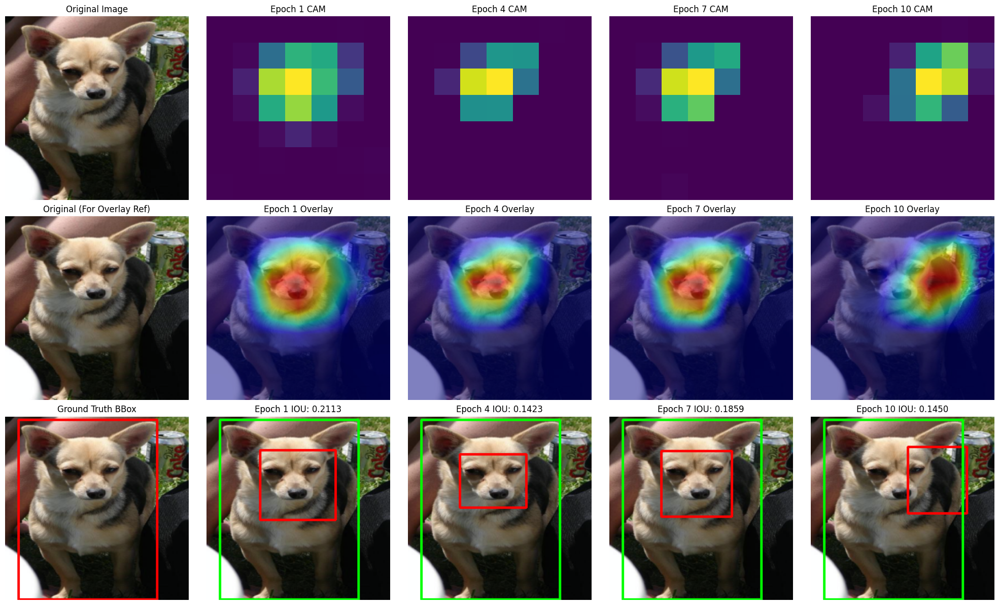

In [26]:
get_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs)

/home/user/anaconda3/envs/torch_gpu/lib/python3.11/site-packages/torch/nn/modules/module.py:1867: FutureWarning: Using a non-full backward hook when the forward contains multiple autograd Nodes is deprecated and will be removed in future versions. This hook will be missing some grad_input. Please use register_full_backward_hook to get the documented behavior.
  self._maybe_warn_non_full_backward_hook(args, result, grad_fn)


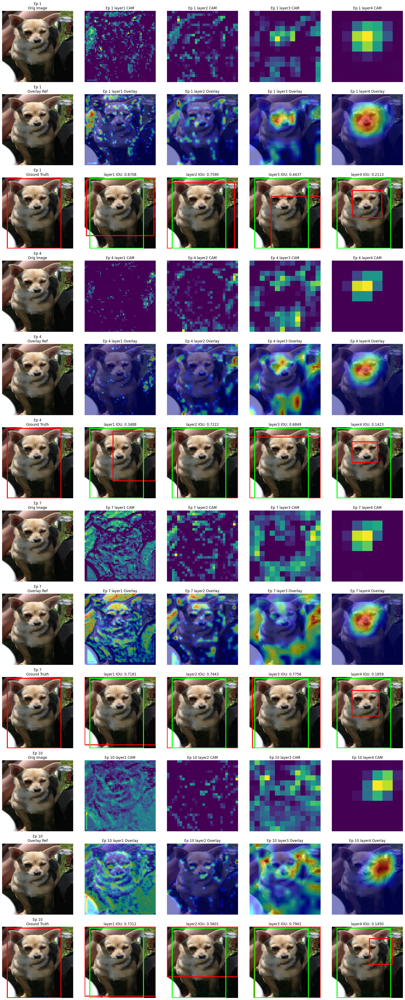

In [27]:
get_grad_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs)

### 여러 객체가 있을 때

In [28]:
image, label, ground_bbox = valid_dataset[326]
item = image.unsqueeze(0).to(device)
orig_img = unnormalize(image)

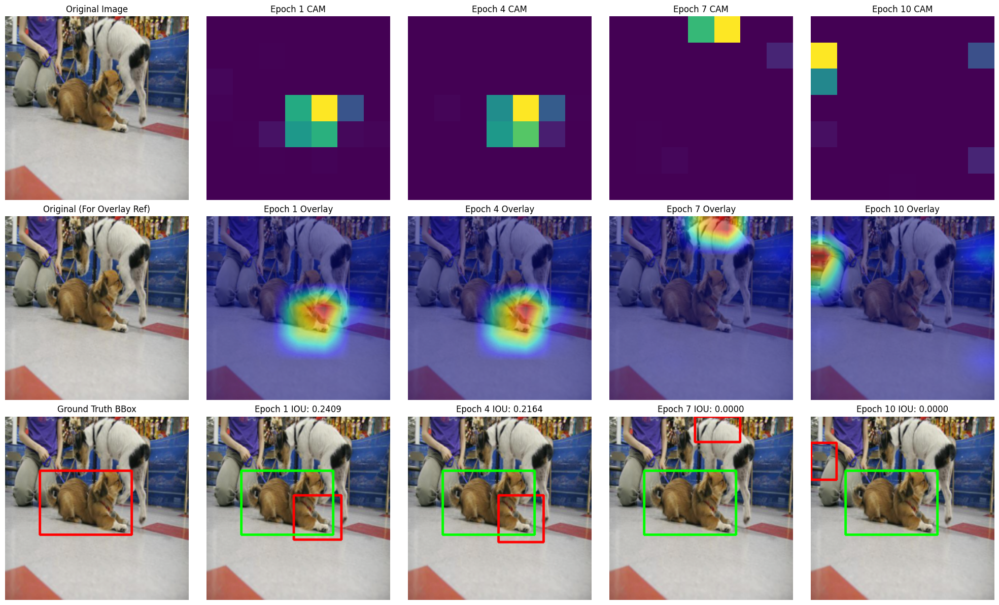

In [29]:
get_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs)

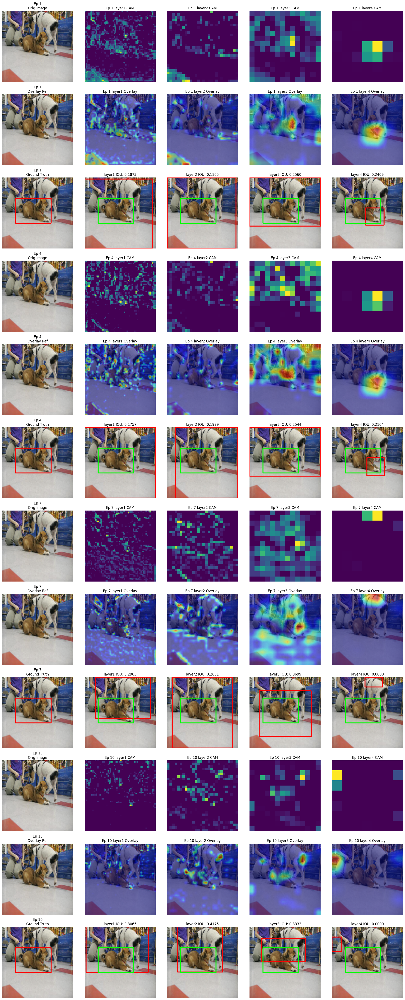

In [30]:
get_grad_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs)

### 객체가 가까이 있을 때

In [31]:
image, label, ground_bbox = valid_dataset[396]
item = image.unsqueeze(0).to(device)
orig_img = unnormalize(image)

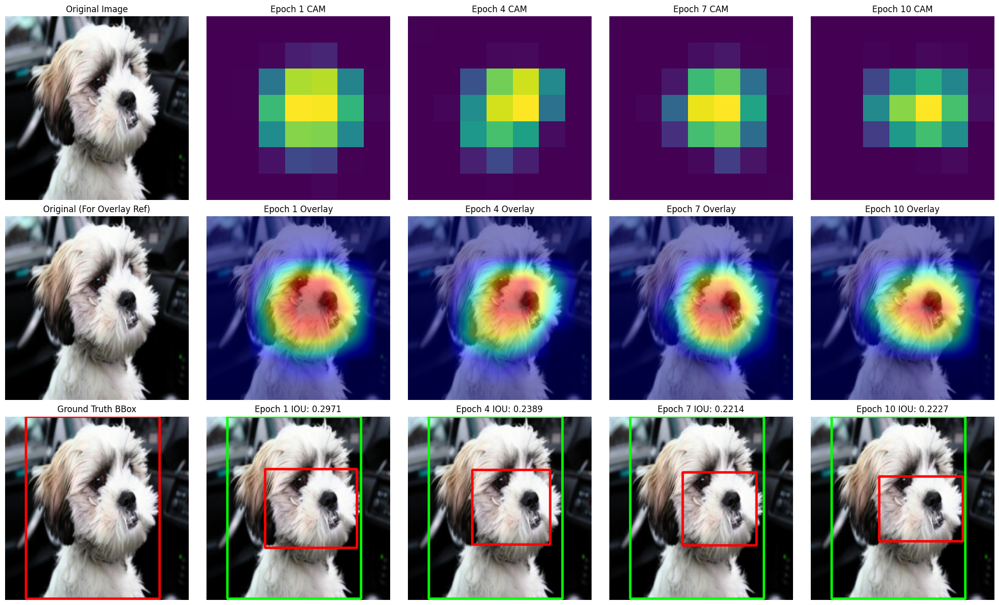

In [32]:
get_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs)

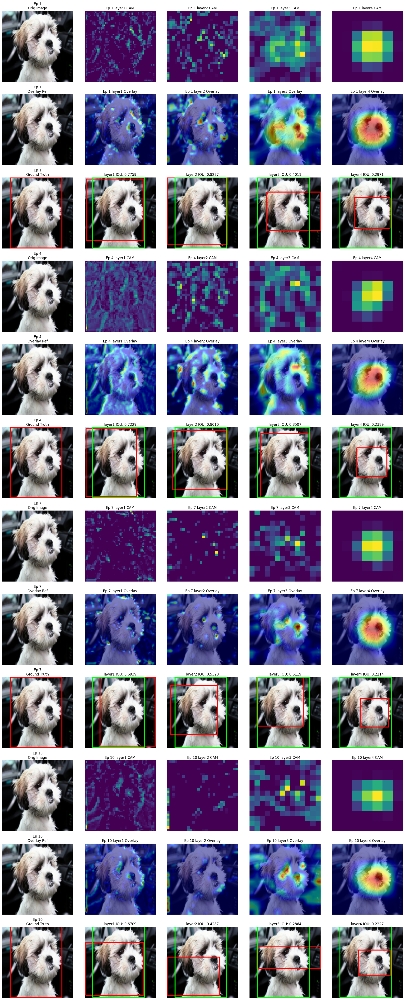

In [33]:
get_grad_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs)

### 객체가 멀리 있을 때

In [34]:
image, label, ground_bbox = valid_dataset[544]
# image, label, ground_bbox = valid_dataset[292]
item = image.unsqueeze(0).to(device)
orig_img = unnormalize(image)

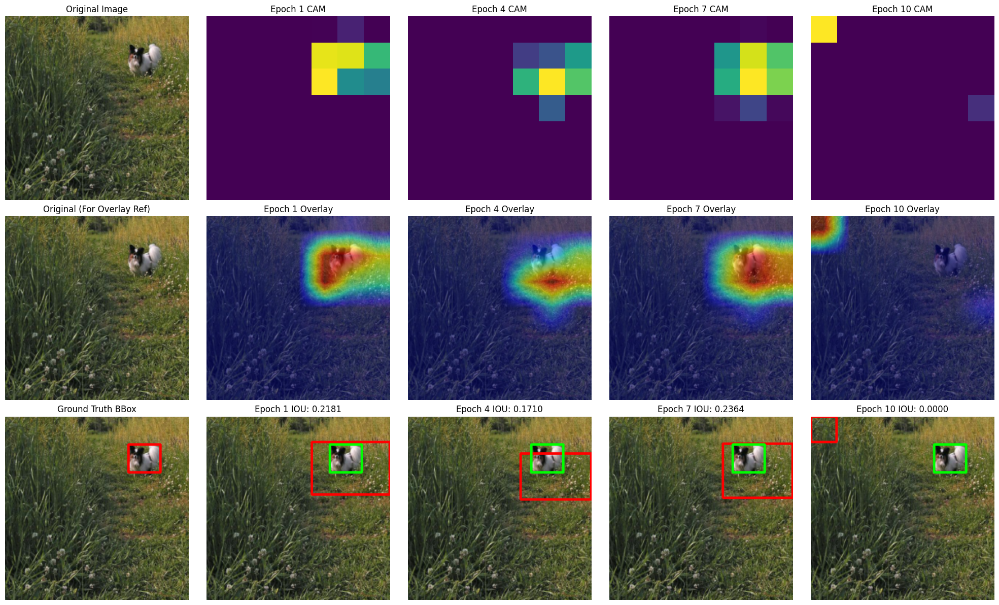

In [35]:
get_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs)

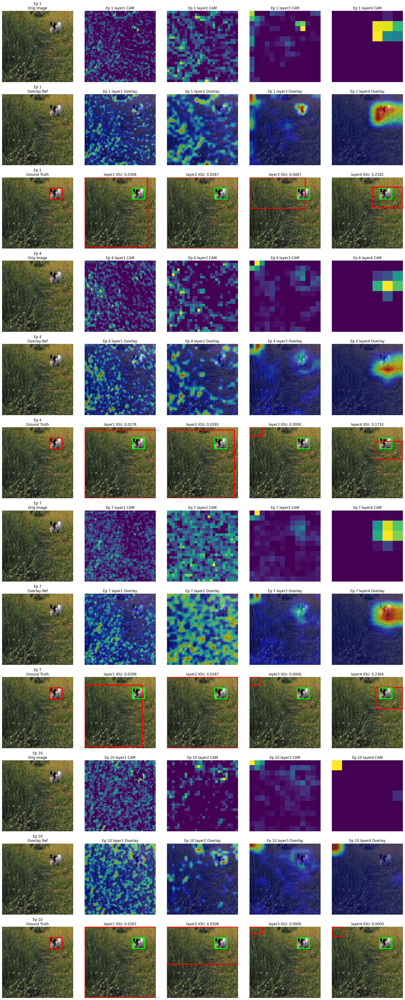

In [ ]:
get_grad_cam(models_list, image, ground_bbox, item, start_epochs, step_epochs)